##### #Code derived from Style GAN github repo

In [1]:
import os
import pickle
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import config
import matplotlib.pyplot as plt

In [2]:
tflib.init_tf()

In [3]:
# Load pre-trained network.
url = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ' # karras2019stylegan-ffhq-1024x1024.pkl
with dnnlib.util.open_url(url, cache_dir=config.cache_dir) as f:
    _G, _D, Gs = pickle.load(f)

In [4]:
# Pick latent vector.
rnd = np.random.RandomState(5)
latents = rnd.randn(1, Gs.input_shape[1])

### Interpolating some random latent inputs from -1 to 1(over the row from left to right)

#### No significant change is observed by just changing 1 single bit of latent variable input from -1 to 1

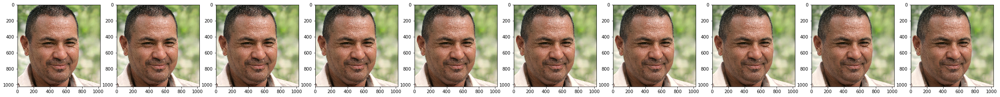

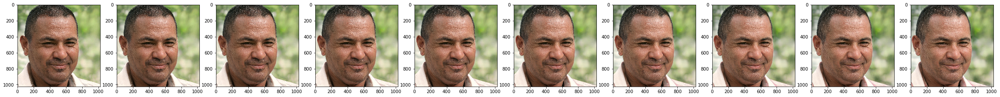

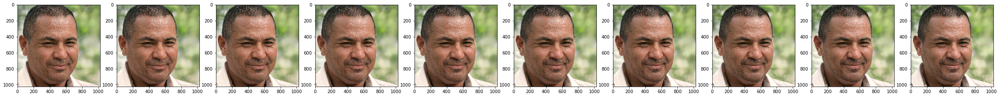

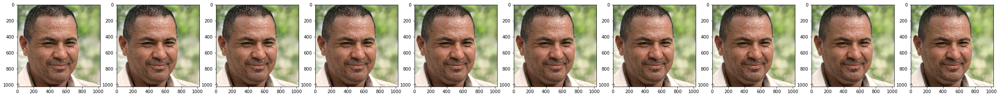

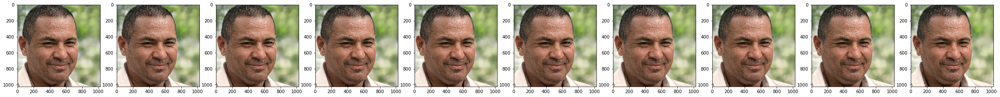

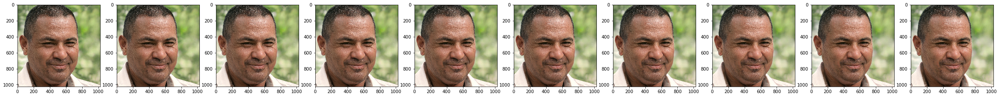

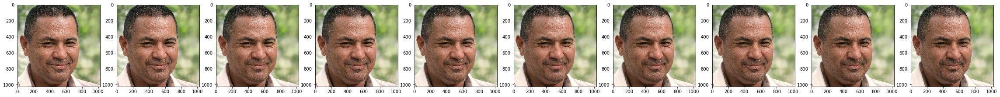

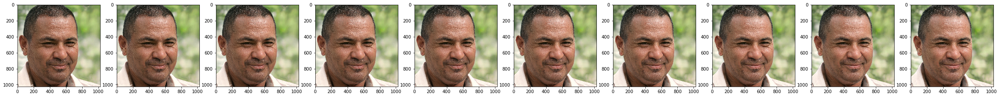

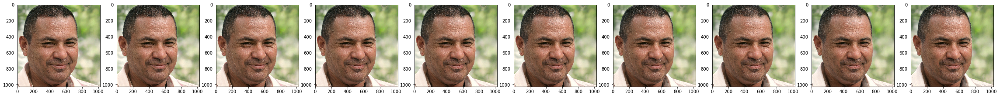

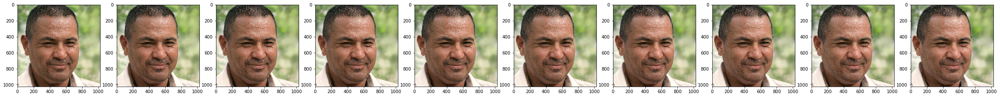

In [6]:
for i in range(10):
    lat_in = np.repeat(latents, 10, axis = 0)
    #print(lat_in.shape)
    #lat_in[:, i:i+20] = np.repeat(np.linspace(-1, 1, 10).reshape(1, -1), 20, axis = 0).T
    lat_in[:, i**2] = np.linspace(-1, 1, 10)
    
    # Generate image.
    fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    images = Gs.run(lat_in, None, truncation_psi=0.7, randomize_noise=False, output_transform=fmt)
    #print(images.shape)
    
    fig, ax= plt.subplots(nrows=1, ncols=10, figsize=(40, 4), squeeze = False)
    for j in range(10):
        ax[0, j].imshow(images[j])
    plt.show()


Changing 20 consecutive bits of input latent simultaneously from -1 to 1

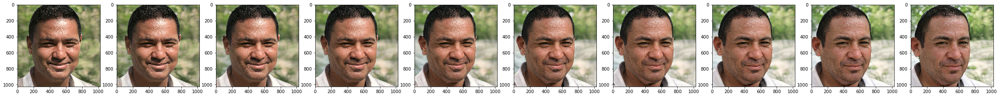

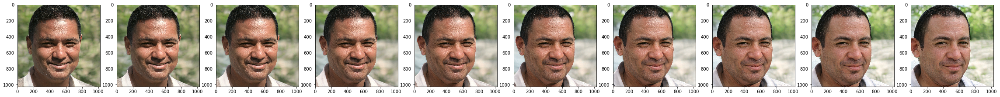

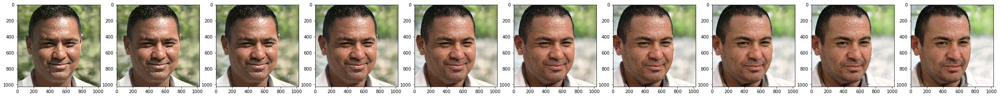

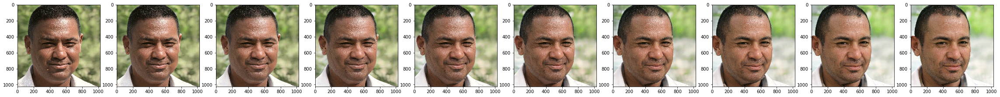

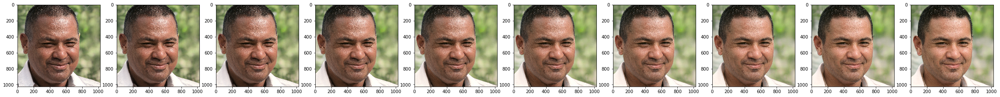

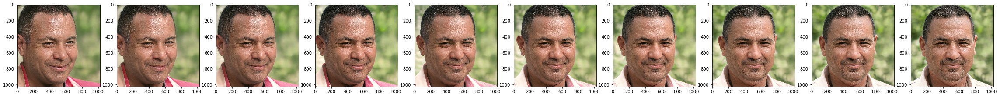

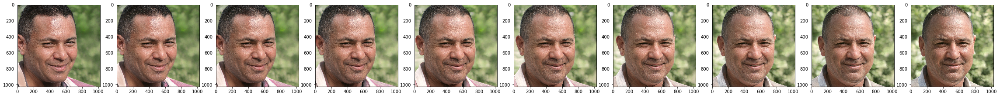

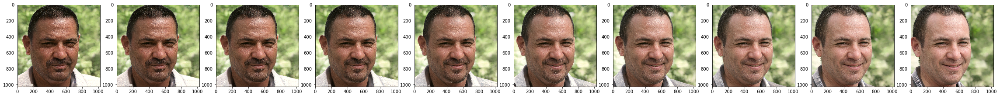

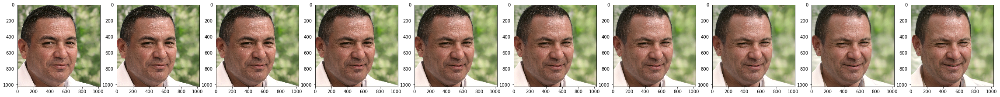

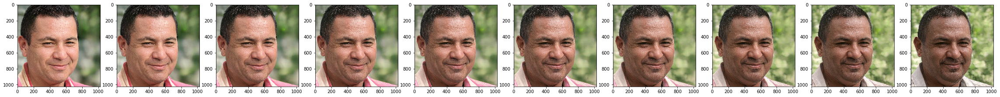

In [7]:
for i in range(10):
    lat_in = np.repeat(latents, 10, axis = 0)
    #print(lat_in.shape)
    lat_in[:, i**2:i**2 + 20] = np.repeat(np.linspace(-1, 1, 10).reshape(1, -1), 20, axis = 0).T
    #lat_in[:, i**2] = np.linspace(-1, 1, 10)
    
    # Generate image.
    fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    images = Gs.run(lat_in, None, truncation_psi=0.7, randomize_noise=False, output_transform=fmt)
    #print(images.shape)
    
    fig, ax= plt.subplots(nrows=1, ncols=10, figsize=(40, 4), squeeze = False)
    for j in range(10):
        ax[0, j].imshow(images[j])
    plt.show()
